## Setup and Briefing

Natural Language Toolkit (NLTK) is a popular platform for building programmes and models in Python that can work with human language data. It provides interfaces for many resources such as WordNet and several libraries for classification, tokenization, stemming, tagging, parsing, and semantic reasoning and more.

Another useful tool is SpaCy which contains a number of functions and properties that are very helpful in preprocessing text data for deep learning NLP work. It interoperates with TensorFlow, PyTorch, Sci-kit Learn and other parts of Python's AI ecosystem. 

In [34]:
# General purpose NLP and data sci imports:
import os
import re
import email
import random
import itertools
import numpy as np
import pandas as pd
import requests
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn as sn
from string import punctuation
from nltk.corpus import stopwords, words
from nltk.stem import WordNetLemmatizer
from nltk import classify
from sklearn import metrics, preprocessing, feature_extraction, linear_model, naive_bayes, ensemble, pipeline, svm, model_selection, decomposition
from sklearn.metrics import accuracy_score, confusion_matrix, roc_curve, roc_auc_score
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB, GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import tree, datasets
from sklearn.utils import resample

## NLTK Basics

In [2]:
# Taking a body of text and splitting it into individual words.

corpus = ("Andy is a data scientist and Andy's boss Megan was looking for him but he was out to lunch. So Megan texted Andy to ask how the project is doing as the deadline is coming up.")

# Remove punctuation marks so you only have words.
punctuation = ".',"
for p in punctuation:
    corpus = corpus.replace(p, '')

# Now see.
print(corpus.split())

['Andy', 'is', 'a', 'data', 'scientist', 'and', 'Andys', 'boss', 'Megan', 'was', 'looking', 'for', 'him', 'but', 'he', 'was', 'out', 'to', 'lunch', 'So', 'Megan', 'texted', 'Andy', 'to', 'ask', 'how', 'the', 'project', 'is', 'doing', 'as', 'the', 'deadline', 'is', 'coming', 'up']


In [3]:
# Regular expression tokens (Regex) for cleaner extraction without needing to define and remove punctuation.
# The below line attributes one or more non-word characters to the word_regex variable.
import re

word_regex = r'\W+'
split_corpus = re.split(word_regex, corpus)
print(split_corpus)

['Andy', 'is', 'a', 'data', 'scientist', 'and', 'Andys', 'boss', 'Megan', 'was', 'looking', 'for', 'him', 'but', 'he', 'was', 'out', 'to', 'lunch', 'So', 'Megan', 'texted', 'Andy', 'to', 'ask', 'how', 'the', 'project', 'is', 'doing', 'as', 'the', 'deadline', 'is', 'coming', 'up']


In [4]:
# Another Regex example.
# Below code pattern matches a word character plus 0 or more word characters or just 1 word character.
word_regex_improved = r"(\w[\w']*\w|\w)"
word_matcher = re.compile(word_regex_improved)
word_matcher.findall(corpus)

['Andy',
 'is',
 'a',
 'data',
 'scientist',
 'and',
 'Andys',
 'boss',
 'Megan',
 'was',
 'looking',
 'for',
 'him',
 'but',
 'he',
 'was',
 'out',
 'to',
 'lunch',
 'So',
 'Megan',
 'texted',
 'Andy',
 'to',
 'ask',
 'how',
 'the',
 'project',
 'is',
 'doing',
 'as',
 'the',
 'deadline',
 'is',
 'coming',
 'up']

In [5]:
# Import NTLK so we can download sample data to practice on:
import nltk
nltk.download('popular')

[nltk_data] Downloading collection 'popular'
[nltk_data]    | 
[nltk_data]    | Downloading package cmudict to
[nltk_data]    |     C:\Users\olive\AppData\Roaming\nltk_data...
[nltk_data]    |   Package cmudict is already up-to-date!
[nltk_data]    | Downloading package gazetteers to
[nltk_data]    |     C:\Users\olive\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gazetteers is already up-to-date!
[nltk_data]    | Downloading package genesis to
[nltk_data]    |     C:\Users\olive\AppData\Roaming\nltk_data...
[nltk_data]    |   Package genesis is already up-to-date!
[nltk_data]    | Downloading package gutenberg to
[nltk_data]    |     C:\Users\olive\AppData\Roaming\nltk_data...
[nltk_data]    |   Package gutenberg is already up-to-date!
[nltk_data]    | Downloading package inaugural to
[nltk_data]    |     C:\Users\olive\AppData\Roaming\nltk_data...
[nltk_data]    |   Package inaugural is already up-to-date!
[nltk_data]    | Downloading package movie_reviews to
[nltk_data]   

True

In [6]:
# Converting words into lists of lower case tokens:

def split_into_words(line):
    word_regex_improved = r"(\w[\w']*\w|\w)"
    word_matcher = re.compile(word_regex_improved)
    return word_matcher.findall(line)

processed_corpus = []

# To handle large text inputs, we use the file as an iterator:

with open("natural-language-data.txt") as f:
    for line in f:
        processed_corpus.extend(split_into_words(line))

processed_corpus = [w.lower() for w in processed_corpus]
print(processed_corpus)

['it', 'is', 'very', 'important', 'to', 'preprocess', 'and', 'tokenize', 'words', 'from', 'language', 'data', 'because', 'any', 'machine', 'learning', 'model', 'you', 'build', 'is', 'only', 'ever', 'as', 'good', 'as', 'the', 'data', 'that', 'you', 'feed', 'into', 'it', 'improper', 'preprocessing', 'will', 'produce', 'a', 'model', 'that', "isn't", 'very', 'good', 'at', 'its', 'job', 'human', 'language', 'is', 'filled', 'with', 'ambiguities', 'that', 'make', 'it', 'incredibly', 'difficult', 'to', 'write', 'software', 'that', 'accurately', 'determines', 'the', 'intended', 'meaning', 'of', 'text', 'or', 'voice', 'data', 'homonyms', 'homophones', 'sarcasm', 'idioms', 'metaphors', 'grammar', 'and', 'usage', 'exceptions', 'variations', 'in', 'sentence', 'structureâ', 'these', 'just', 'a', 'few', 'of', 'the', 'irregularities', 'of', 'human', 'language', 'that', 'take', 'humans', 'years', 'to', 'learn', 'but', 'that', 'programmers', 'must', 'teach', 'natural', 'language', 'driven', 'application

In [7]:
# Dealing with stop words and uncommon words:
# Uncommon words should be removed because they introduce more noise than value to the text data.
# Stop words are common words that don't add any additional meaning to text data, such as 'and'.
import collections

# Before stop word removal:
word_counts = collections.Counter(processed_corpus)
print(word_counts)

Counter({'that': 6, 'to': 5, 'language': 4, 'the': 4, 'it': 3, 'is': 3, 'and': 3, 'data': 3, 'of': 3, 'very': 2, 'from': 2, 'model': 2, 'you': 2, 'as': 2, 'good': 2, 'a': 2, 'human': 2, 'accurately': 2, 'applications': 2, 'important': 1, 'preprocess': 1, 'tokenize': 1, 'words': 1, 'because': 1, 'any': 1, 'machine': 1, 'learning': 1, 'build': 1, 'only': 1, 'ever': 1, 'feed': 1, 'into': 1, 'improper': 1, 'preprocessing': 1, 'will': 1, 'produce': 1, "isn't": 1, 'at': 1, 'its': 1, 'job': 1, 'filled': 1, 'with': 1, 'ambiguities': 1, 'make': 1, 'incredibly': 1, 'difficult': 1, 'write': 1, 'software': 1, 'determines': 1, 'intended': 1, 'meaning': 1, 'text': 1, 'or': 1, 'voice': 1, 'homonyms': 1, 'homophones': 1, 'sarcasm': 1, 'idioms': 1, 'metaphors': 1, 'grammar': 1, 'usage': 1, 'exceptions': 1, 'variations': 1, 'in': 1, 'sentence': 1, 'structureâ': 1, 'these': 1, 'just': 1, 'few': 1, 'irregularities': 1, 'take': 1, 'humans': 1, 'years': 1, 'learn': 1, 'but': 1, 'programmers': 1, 'must': 1, 

In [8]:
# Define stop words: you could write a full dictionary-style list here but instead NLTK has a built-in library of stop words.
from nltk.corpus import stopwords
# add nltk.download('stopwords') if you need to download.
stop_words = stopwords.words('english')

In [9]:
# Identify the 10 least common words and remove them:
rare_words = word_counts.most_common()[:-10:-1]

In [10]:
# Now execute stop word and uncommon word removal.
processed_corpus = [w for w in processed_corpus if w not in stop_words]
processed_corpus = [w for w in processed_corpus if w not in rare_words]
print(processed_corpus)

['important', 'preprocess', 'tokenize', 'words', 'language', 'data', 'machine', 'learning', 'model', 'build', 'ever', 'good', 'data', 'feed', 'improper', 'preprocessing', 'produce', 'model', 'good', 'job', 'human', 'language', 'filled', 'ambiguities', 'make', 'incredibly', 'difficult', 'write', 'software', 'accurately', 'determines', 'intended', 'meaning', 'text', 'voice', 'data', 'homonyms', 'homophones', 'sarcasm', 'idioms', 'metaphors', 'grammar', 'usage', 'exceptions', 'variations', 'sentence', 'structureâ', 'irregularities', 'human', 'language', 'take', 'humans', 'years', 'learn', 'programmers', 'must', 'teach', 'natural', 'language', 'driven', 'applications', 'recognize', 'understand', 'accurately', 'start', 'applications', 'going', 'useful']


## Applying NLP techniques for email spam classification using Naive Bayes algorithm from NLTK

In [11]:
# Find and import Enron data.
url = ('http://nlp.cs.aueb.gr/software_and_datasets/Enron-Spam/index.html')

# Set up functions:

# Loads data files into memory
def load_files(directory):
    result = []
    for fname in os.listdir(directory):
        with open(directory + fname, 'r', encoding='UTF-8', errors='ignore') as f:
            result.append(f.read())
    return result

# Applies all preprocessing steps in a single function
def preprocess_sentence(sentence):
    lemmatizer = nltk.WordNetLemmatizer()
    # Processing pipeline:
    processed_tokens = nltk.word_tokenize(sentence)
    processed_tokens = [w.lower() for w in processed_tokens]
    # Find the 10 least common words:
    word_counts = collections.Counter(processed_tokens)
    uncommon_words = word_counts.most_common()[:-10:-1]
    # Execute removal of stopwords and uncommon words:
    processed_tokens = [w for w in processed_tokens if w not in stop_words]
    processed_tokens = [w for w in processed_tokens if w not in uncommon_words]
    # Lemmatize the output so far:
    processed_tokens = [lemmatizer.lemmatize(w) for w in processed_tokens]
    return processed_tokens

# Converts each word token into a feature.
def feature_extractor(tokens):
    return dict(collections.Counter(tokens))

# Applies train/test split at 70:30 ratio.
def train_test_splitter(dataset, train_size = 0.7):
    training_examples = int(len(dataset) * train_size)
    return dataset[:training_examples], dataset[training_examples:]

Lemmatization = the process of grouping together the inflected forms of a word so they can be analysed as a single item, identified by the word's lemma, or dictionary form.

Stemming = the process of reducing inflected words to their word stem, base or root form—generally a written word form.

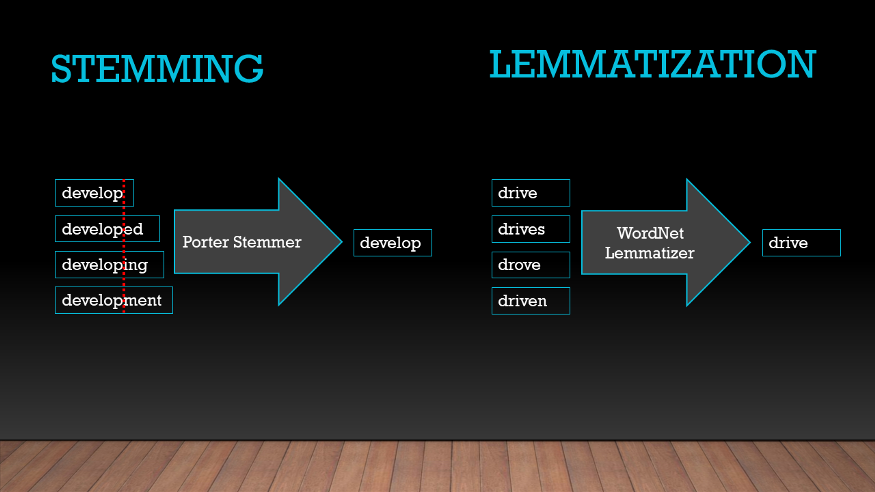

In [12]:
# Identify spam and non-spam data:
positive_examples = load_files('Raw Enron Data\spam/')
negative_examples = load_files('Raw Enron Data\ham/')

# Start preprocessing and label the examples:
positive_examples = [preprocess_sentence(email) for email in positive_examples]
negative_examples = [preprocess_sentence(email) for email in negative_examples]
# 1 for positive, 0 for negative.
positive_examples = [(email, 1) for email in positive_examples]
negative_examples = [(email, 0) for email in negative_examples]

# Add together and shuffle so the model later on gets a mix of positive and negative samples during training.
all_examples = positive_examples + negative_examples
random.shuffle(all_examples)

# Feature tokenization using bag of words approach.
featurized = [(feature_extractor(corpus), label)
for corpus, label in all_examples]

# Apply test/train split:
training_set, test_set = train_test_splitter(featurized, train_size = 0.7)

# Building NB model and setting up evaluation metric:
model_nb = nltk.classify.NaiveBayesClassifier.train(training_set)
training_error = nltk.classify.accuracy(model_nb, training_set)
print('Model Accuracy on Training Dataset: {}'.format(training_error))
testing_error = nltk.classify.accuracy(model_nb, test_set)
print('Model Accuracy on Test Data: {}'.format(testing_error))

Model Accuracy on Training Dataset: 0.9958759343586219
Model Accuracy on Test Data: 0.9882730279643179


## Sentiment Analysis on Movie Review Dataset

In [13]:
# Load using Scikit-Learn datasets library:
url = 'https://www.cs.cornell.edu/people/pabo/movie-review-data/'

data_directory = 'Film Reviews'
movie_sentiment_data = datasets.load_files(data_directory, shuffle=True, load_content = True)
print('File classes: {}'.format(movie_sentiment_data.target_names))

File classes: ['negative', 'positive']


In [14]:
# Build new feature extractor using a vectorizer, to extract TF-IDF features:
def feature_vectorizer(corpus):
    sa_stop_words = nltk.corpus.stopwords.words('english')
    # Create a list of exceptions, as these stopwords may change a sentence's sentiment if removed.
    sa_white_list = ['what', 'but', 'if', 'because', 'as', 'until', 'against', 'up', 'down', 'in', 'out',
                    'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'why',
                    'how', 'all', 'any', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own',
                    'same', 'so', 'than', 'too', 'can', 'will', 'just', 'don', 'should']
    # Remove stop words except for those specified in the white list.
    sa_stop_words = [sw for sw in sa_stop_words if sw not in sa_white_list]
    # Instantiate the vectorizer.
    count_vectorizer = feature_extraction.text.CountVectorizer(
        lowercase = True,
        tokenizer = nltk.word_tokenize,
        min_df=2, # this means the term frequency must be 2 or higher.
        ngram_range=(1,2),
        stop_words=sa_stop_words
    )
    # Run the vectorizer on the body of text ('corpus').
    processed_corpus = count_vectorizer.fit_transform(corpus)
    processed_corpus = feature_extraction.text.TfidfTransformer().fit_transform(processed_corpus)
    return processed_corpus

# Extract features from review text:
movie_data = feature_vectorizer(movie_sentiment_data.data)

# Inspect output to check if successful.
movie_data

c:\Users\olive\Anaconda3\envs\DeepLearn_Env\lib\site-packages\sklearn\feature_extraction\text.py:525: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(
c:\Users\olive\Anaconda3\envs\DeepLearn_Env\lib\site-packages\sklearn\feature_extraction\text.py:408: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", 'could', 'might', 'must', "n't", 'need', 'sha', 'should', 'wo', 'would'] not in stop_words.
  warnings.warn(


<2000x123593 sparse matrix of type '<class 'numpy.float64'>'
	with 1154597 stored elements in Compressed Sparse Row format>

TF-IDF helps us understand how important a word is in a piece of writing: it looks at how often a word shows up in that writing (Term Frequency) and balances it against how common the word is in all the writings we're looking at (Inverse Document Frequency). This way, it highlights words that are important in a particular piece but not so common in general.

N-grams are sequences of n consecutive words in a piece of text. They're used in natural language processing to analyze patterns and relationships between words. For example, in the sentence "The cat sat on the mat," the 2-grams (also called bigrams) would be "The cat", "cat sat", "sat on", "on the", and "the mat". N-grams help with tasks like text prediction, language modeling, and sentiment analysis.

In [15]:
# Instantiate train/test split:
X_train, X_test, y_train, y_test = train_test_split(movie_data, movie_sentiment_data.target, test_size = 0.3, random_state=123)

# Begin sentiment analysis using Logistic Regression.
model_lr = LogisticRegression()
model_lr.fit(X_train, y_train)

# Print model performance after fitting. 
print('Model Performance: {}'.format(model_lr.score(X_test, y_test)))

# Inspect accuracy of y_pred to judge performance of logistic regressor:
y_pred = model_lr.predict(X_test)
for i in range(5):
    print('Review:\n{review}\n-\nCorrect Label: {correct}; Predicted: {predict}'.format(
        review = X_test[i], correct = y_test[i], predict = y_pred[i]))

Model Performance: 0.8033333333333333
Review:
  (0, 123266)	0.05725027364736704
  (0, 123237)	0.020990458458441445
  (0, 122581)	0.058448518933300574
  (0, 122428)	0.02639223055752631
  (0, 121119)	0.05261384762480841
  (0, 120967)	0.013970622861697429
  (0, 119879)	0.06453869545236457
  (0, 119874)	0.029224259466650287
  (0, 119859)	0.07331914525463934
  (0, 119256)	0.033324115627355405
  (0, 119252)	0.021100039041128404
  (0, 117515)	0.11715254307717297
  (0, 117382)	0.06453869545236457
  (0, 117378)	0.024783024042254805
  (0, 116875)	0.06453869545236457
  (0, 116743)	0.01158877036583784
  (0, 113912)	0.05128784973358896
  (0, 113909)	0.10312628023047167
  (0, 113139)	0.021380257937008117
  (0, 112460)	0.02469882800876784
  (0, 112374)	0.01842107784660065
  (0, 112169)	0.03833175123784752
  (0, 112076)	0.019049237094060784
  (0, 111808)	0.04961772757775557
  (0, 111727)	0.05508847713562324
  :	:
  (0, 12147)	0.05508847713562324
  (0, 11795)	0.035672799119400876
  (0, 11784)	0.0403378

In [16]:
# Let's try some other classifier models and see how they do in comparison.
# Test Stochastic Gradient Descent:
model_SGD = linear_model.SGDClassifier()
model_SGD.fit(X_train, y_train)
print('SGD Classifier Performance: {:.4f}'.format(model_SGD.score(X_test, y_test)))

# Try a multinomial Naive Bayes:
model_NBMult = naive_bayes.MultinomialNB()
model_NBMult.fit(X_train, y_train)
print('Multinomial NB Performance: {:.4f}'.format(model_NBMult.score(X_test, y_test)))

# Try a Bernoulli Naive Bayes:
model_NBBer = naive_bayes.BernoulliNB()
model_NBBer.fit(X_train, y_train)
print('Bernoulli NB Performance: {:.4f}'.format(model_NBBer.score(X_test, y_test)))

# We can also combine multiple models together using a Voting model:
voting_model = ensemble.VotingClassifier(
    estimators=[('LR', model_lr), ('SGD', model_SGD), ('M-NB', model_NBMult), 
                ('Bernoulli NB', model_NBBer)],
    voting='hard')
voting_model.fit(X_train, y_train)
print('Voting Classifier Performance: {:.4f}'.format(voting_model.score(X_test, y_test)))

SGD Classifier Performance: 0.8633
Multinomial NB Performance: 0.8083
Bernoulli NB Performance: 0.8150
Voting Classifier Performance: 0.8317


## Advanced Cleaning of Tokens using string functions and regular expressions ('regex')

In [17]:
# Acquire a dictionary of English words.
english_words = words.raw().split('\n')
print(f'Total words of English language that NLTK holds: ', len(english_words))

Total words of English language that NLTK holds:  236737


In [18]:
# Exploring wildcards:
pattern = re.compile('t..t')
[w for w in english_words if pattern.match(w)][:10]

['tact',
 'tactable',
 'tactful',
 'tactfully',
 'tactfulness',
 'tactic',
 'tactical',
 'tactically',
 'tactician',
 'tactics']

In [19]:
# Exploring Endings:
pattern = re.compile('t..t$') # the $ tells Python that the second t is the end of the word.
[w for w in english_words if pattern.match(w)][:10]

['tact',
 'taft',
 'tait',
 'takt',
 'tart',
 'taut',
 'teat',
 'teet',
 'telt',
 'tent']

In [20]:
# Optionality:
pattern = re.compile('humou?r$') # the ? allows the result to have the u or not and still be displayed.
[w for w in english_words if pattern.match(w)][:10]

['humor', 'humour']

In [21]:
# One or more duplicate letters ('+'):
pattern = re.compile('co+l$')
[w for w in english_words if pattern.match(w)][:10]

['col', 'cool']

In [22]:
# Grouped choices:
pattern = re.compile('analy[sz]e') # this allows variation in spelling between s and z.
[w for w in english_words if pattern.match(w)][:10]

['analyse', 'analyser', 'analyses', 'analyze', 'analyzer']

## Newsgroup Document Classification

In [23]:
# Load dataset
data_directory = ('Newsgroups\DSnewsgroups/')
if __name__ == '__main__':
    newsgroup_data = datasets.load_files(data_directory, shuffle=True, random_state=123, encoding='ISO-8859-1')
    print('Data loaded.\nClasses = {classes}|{datapoints}'.format(classes = newsgroup_data.target_names,
                                                                datapoints = newsgroup_data.data))

Data loaded.
Classes = ['alt.atheism', 'comp.graphics', 'comp.os.ms-windows.misc', 'comp.sys.ibm.pc.hardware', 'comp.sys.mac.hardware', 'comp.windows.x', 'misc.forsale', 'rec.autos', 'rec.motorcycles', 'rec.sport.baseball', 'rec.sport.hockey', 'sci.crypt', 'sci.electronics', 'sci.med', 'sci.space', 'soc.religion.christian', 'talk.politics.guns', 'talk.politics.mideast', 'talk.politics.misc', 'talk.religion.misc']|['Path: cantaloupe.srv.cs.cmu.edu!magnesium.club.cc.cmu.edu!news.sei.cmu.edu!cis.ohio-state.edu!magnus.acs.ohio-state.edu!csn!ncar!gatech!usenet.ufl.edu!usenet.cis.ufl.edu!caen!uvaarpa!clem!clem!news\nFrom: jmd@cube.handheld.com (Jim De Arras)\nNewsgroups: talk.politics.guns\nSubject: Re: BD\'s did themselves--you\'re all paranoid freaks\nDate: 24 Apr 1993 00:27:58 GMT\nOrganization: Hand Held Products, Inc.\nLines: 40\nDistribution: world\nMessage-ID: <1ra1ieINNcli@clem.handheld.com>\nReferences: <1993Apr23.151855.7011@starbase.trincoll.edu>\nNNTP-Posting-Host: dale.handheld.

In [24]:
# Inspect loaded set:
print(newsgroup_data.data[0])

Path: cantaloupe.srv.cs.cmu.edu!magnesium.club.cc.cmu.edu!news.sei.cmu.edu!cis.ohio-state.edu!magnus.acs.ohio-state.edu!csn!ncar!gatech!usenet.ufl.edu!usenet.cis.ufl.edu!caen!uvaarpa!clem!clem!news
From: jmd@cube.handheld.com (Jim De Arras)
Newsgroups: talk.politics.guns
Subject: Re: BD's did themselves--you're all paranoid freaks
Date: 24 Apr 1993 00:27:58 GMT
Organization: Hand Held Products, Inc.
Lines: 40
Distribution: world
Message-ID: <1ra1ieINNcli@clem.handheld.com>
References: <1993Apr23.151855.7011@starbase.trincoll.edu>
NNTP-Posting-Host: dale.handheld.com

In article <1993Apr23.151855.7011@starbase.trincoll.edu>  () writes:
> In article <1r6p8oINN8hi@clem.handheld.com>, jmd@cube.handheld.com (Jim De
> Arras) wrote:
> >  
> > I have not made up my mind about Waco, but there sure seems to be a group  
of  
> > devoted government following fanatics willing to believe whatever that  
> > government wants to tell them, without any shred of doubt, nor thought of  
thier
> > own.  

In [25]:
# Instantiate train/test split:
X_train, X_test, y_train, y_test = train_test_split(newsgroup_data.data, newsgroup_data.target, test_size = 0.3, random_state=123)

# Instantiate stop word dictionary:
stop_words = nltk.corpus.stopwords.words('english')

# Build classification pipeline:
model = pipeline.Pipeline([
    ('counts', feature_extraction.text.CountVectorizer(
        lowercase = True,
        tokenizer = nltk.word_tokenize,
        min_df = 2,
        ngram_range = (1, 2),
        stop_words = stop_words
    )),
    ('TF-IDF', feature_extraction.text.TfidfTransformer()),
    ('NaiveBayes', naive_bayes.MultinomialNB())
])

# Fit and run the model:
model.fit(X_train, y_train)
y_pred = model.predict(X_test)

# Produce accuracy metrics:
print('Multinomial Naive Bayes: {}'.format(np.mean(y_pred == y_test)))
print(metrics.classification_report(y_test, y_pred, target_names = newsgroup_data.target_names))

c:\Users\olive\Anaconda3\envs\DeepLearn_Env\lib\site-packages\sklearn\feature_extraction\text.py:525: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(
c:\Users\olive\Anaconda3\envs\DeepLearn_Env\lib\site-packages\sklearn\feature_extraction\text.py:408: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Multinomial Naive Bayes: 0.8878333333333334
                          precision    recall  f1-score   support

             alt.atheism       0.75      0.87      0.81       296
           comp.graphics       0.91      0.86      0.88       285
 comp.os.ms-windows.misc       0.96      0.85      0.90       305
comp.sys.ibm.pc.hardware       0.81      0.88      0.84       298
   comp.sys.mac.hardware       0.93      0.90      0.91       289
          comp.windows.x       0.84      0.96      0.90       294
            misc.forsale       0.84      0.88      0.86       320
               rec.autos       0.97      0.93      0.95       294
         rec.motorcycles       0.96      0.96      0.96       295
      rec.sport.baseball       0.99      0.90      0.94       315
        rec.sport.hockey       0.92      0.96      0.94       309
               sci.crypt       0.92      0.98      0.95       297
         sci.electronics       0.97      0.86      0.91       323
                 sci.med       

In [26]:
# Model optimization using GridSearchCV:
optimizer = model_selection.GridSearchCV(
    model,
    {'counts__ngram_range': [(1, 1), (1, 2)], 
    'NaiveBayes__alpha': (0.1, 3.0)},
    n_jobs=-1)

# Fit the Grid Search algorithm:
optimizer.fit(X_train, y_train)

# Get results:
print('Best parameters found:', optimizer.best_params_)
print('Best score found:', optimizer.best_score_)

# Access the complete results including mean test scores, std test scores, etc if wanted:
print('Grid Search Optimizer Results: ', optimizer.cv_results_)

c:\Users\olive\Anaconda3\envs\DeepLearn_Env\lib\site-packages\sklearn\feature_extraction\text.py:525: UserWarning: The parameter 'token_pattern' will not be used since 'tokenizer' is not None'
  warnings.warn(
c:\Users\olive\Anaconda3\envs\DeepLearn_Env\lib\site-packages\sklearn\feature_extraction\text.py:408: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ["'d", "'ll", "'re", "'s", "'ve", 'could', 'might', 'must', "n't", 'need', 'sha', 'wo', 'would'] not in stop_words.
  warnings.warn(


Best parameters found: {'NaiveBayes__alpha': 0.1, 'counts__ngram_range': (1, 1)}
Best score found: 0.8955485122237533
Grid Search Optimizer Results:  {'mean_fit_time': array([60.79001341, 71.06380591, 62.89982901, 68.98813419]), 'std_fit_time': array([3.33079867, 3.25363403, 3.64839544, 2.21990597]), 'mean_score_time': array([14.77135758, 14.98513021, 13.72945347, 13.62362061]), 'std_score_time': array([1.24060454, 0.70560561, 0.36691848, 0.6698028 ]), 'param_NaiveBayes__alpha': masked_array(data=[0.1, 0.1, 3.0, 3.0],
             mask=[False, False, False, False],
       fill_value='?',
            dtype=object), 'param_counts__ngram_range': masked_array(data=[(1, 1), (1, 2), (1, 1), (1, 2)],
             mask=[False, False, False, False],
       fill_value='?',
            dtype=object), 'params': [{'NaiveBayes__alpha': 0.1, 'counts__ngram_range': (1, 1)}, {'NaiveBayes__alpha': 0.1, 'counts__ngram_range': (1, 2)}, {'NaiveBayes__alpha': 3.0, 'counts__ngram_range': (1, 1)}, {'NaiveBaye

## Text Preprocessing Pipelines with NLTK

In [27]:
# Define your example text
corpus = [
    "This is a sample sentence for testing the data pipeline.",
    "Another example sentence to process through the pipeline.",
    "This is a great way to efficiently feed text data through the pipeline.",
    "However, setting up these pipelines can be complex and require significant time and expertise."
]

# Begin pipeline construction and assembly.
# Docstrings added to benefit explainability:
def pipeline(f):
    """
    Decorator function for creating a pipeline.
    Args: #
    f (function): The generator function to be wrapped.
    Returns:
    function: A generator function that initializes and starts the pipeline.
    """
    def start_pipeline(*args, **kwargs):
        """
        Initializes and starts the pipeline.
        Args:
            *args: Positional arguments passed to the decorated function.
            **kwargs: Keyword arguments passed to the decorated function.
        Returns:
            generator: A generator instance initialized and ready to be started.
        """
        nf = f(*args, **kwargs)
        next(nf)
        return nf
    return start_pipeline

@pipeline
def ingest(corpus, targets):
    """
    Ingests text data into the pipeline.
    Args:
        corpus (iterable): A collection of text data to be ingested.
        targets (iterable): A collection of pipeline targets to receive the ingested data.
    """
    for text in corpus:
        for t in targets:
            t.send(text)
        yield

@pipeline
def tokenize_sentences(targets):
    while True:
        text = (yield)
        sentences = nltk.sent_tokenize(text)
        for sentence in sentences:
            for target in targets:
                target.send(sentence)

@pipeline
def tokenize_words(targets):
    """
    Tokenizes words using NLTK word_tokenize function.
    Args:
        targets (iterable): A collection of pipeline targets to receive the tokenized words.
    """
    while True:
        sentence = (yield)
        words = nltk.word_tokenize(sentence)
        for target in targets:
            target.send(words)

@pipeline
def pos_tagging(targets):
    """
    Performs part-of-speech tagging using NLTK pos_tag function.
    Args:
        targets (iterable): A collection of pipeline targets to receive the tagged words.
    """
    while True:
        words = (yield)
        tagged_words = nltk.pos_tag(words)
        
        for target in targets:
            target.send(tagged_words)

@pipeline
def ne_chunking(targets):
    """
    Performs named entity recognition using NLTK ne_chunk function.
    Args:
        targets (iterable): A collection of pipeline targets to receive the named entity tagged words.
    """
    while True:
        tagged_words = (yield)
        ner_tagged = nltk.ne_chunk(tagged_words)
        for target in targets:
            target.send(ner_tagged)

@pipeline
def printline(title):
    """
    Prints lines received by the pipeline with an optional title.
    Args:
        title (str): The title to be printed before each line.
    """
    while True:
        line = (yield)
        print(title)
        print(line)

In [28]:
# Now run the pipeline on our example text:
# Construct the pipeline targets
pipeline_targets = [
    tokenize_sentences([
        tokenize_words([
            pos_tagging([
                ne_chunking([
                    printline('Results')
                ])
            ])
        ])
    ])
]

# Now run the pipeline on the corpus
ingest(corpus, pipeline_targets)

Results
(S
  This/DT
  is/VBZ
  a/DT
  sample/JJ
  sentence/NN
  for/IN
  testing/VBG
  the/DT
  data/NNS
  pipeline/NN
  ./.)


<generator object ingest at 0x0000024EC5491AF0>

In [30]:
# Hashing-based features from natural language:
hash_vectorizer = feature_extraction.text.HashingVectorizer(
    norm = None, alternate_sign = False)
X = hash_vectorizer.transform(corpus)
print('Resulting Term-Document Matrix has {} datapoints and {} features:'.format(X.shape[0], X.shape[1]))

Resulting Term-Document Matrix has 4 datapoints and 1048576 features:


Hash vectorization in NLP offers benefits including memory efficiency, scalability, and flexibility. It saves memory by not storing a vocabulary dictionary, making it suitable for large datasets and memory-constrained environments. Its simplicity enables faster experimentation and integration into pipelines without the need for extensive preprocessing. Hashing reduces dimensionality and computation time while potentially preventing information leakage between training and test sets. However, its use should be considered based on specific task requirements and constraints.

## Classifying documents using latent semantic analysis (LSA)

In [36]:
# Matrix Decomposition
# First instantiate train/test split: 
X_train, X_test, y_train, y_test = model_selection.train_test_split(newsgroup_data.data, newsgroup_data.target, 
                                                                    test_size=0.3, random_state=123)

# Instantiate desired models:
lsa_model = pipeline.Pipeline([
    ('counts', feature_extraction.text.CountVectorizer()),
    ('TF-IDF', feature_extraction.text.TfidfTransformer()),
    ('SVD', decomposition.TruncatedSVD(128)),
    ('Normalise', preprocessing.Normalizer(copy=False)),
    ('Gaussian NB', naive_bayes.GaussianNB())
])

# Fit model and run predictions from text data:
lsa_model.fit(X_train, y_train)
y_pred = lsa_model.predict(X_test)
print(lsa_model.score(X_test, y_test))

0.7476666666666667


In [38]:
# Classification using TF-IDF and SVM:
svm_model = pipeline.Pipeline([
    ('Counts', feature_extraction.text.CountVectorizer()),
    ('TF-IDF', feature_extraction.text.TfidfTransformer()),
    ('SVM', svm.LinearSVC())
])

# Fit model and run predictions from text data:
svm_model.fit(X_train, y_train)
y_pred = lsa_model.predict(X_test)

# Produce and print accuracy score:
print('Accuracy Score of SVC = {}'.format(
    np.mean(y_pred == y_test)))

c:\Users\olive\Anaconda3\envs\DeepLearn_Env\lib\site-packages\sklearn\svm\_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


Accuracy Score of SVC = 0.7476666666666667


In [40]:
# Print more detailed performance metrics:
print('Classification Report: \n', metrics.classification_report(
    y_test, y_pred, target_names=newsgroup_data.target_names))

Classification Report: 
                           precision    recall  f1-score   support

             alt.atheism       0.54      0.66      0.59       296
           comp.graphics       0.91      0.73      0.81       285
 comp.os.ms-windows.misc       0.91      0.73      0.81       305
comp.sys.ibm.pc.hardware       0.76      0.75      0.76       298
   comp.sys.mac.hardware       0.81      0.69      0.74       289
          comp.windows.x       0.74      0.77      0.75       294
            misc.forsale       0.91      0.77      0.84       320
               rec.autos       0.78      0.79      0.78       294
         rec.motorcycles       0.75      0.80      0.78       295
      rec.sport.baseball       0.85      0.76      0.80       315
        rec.sport.hockey       0.82      0.81      0.81       309
               sci.crypt       0.92      0.78      0.85       297
         sci.electronics       0.64      0.62      0.63       323
                 sci.med       0.86      0.73     